## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [ ]:
!nvidia-smi

Tue Aug 27 18:37:54 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   63C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# **Mount to Drive**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/Detection-Potholes-v2

/content/drive/MyDrive/Detection-Potholes-v2


In [3]:
import os
HOME = os.getcwd()
print(HOME)

/content/drive/MyDrive/Detection-Potholes-v2


# **Install YOLOv8**

In [4]:
!pip -q install --upgrade ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 871.1/871.1 kB 21.6 MB/s eta 0:00:00


In [5]:
# Pip install method (recommended)

# !pip -q install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.8/107.7 GB disk)


In [6]:
ultralytics.__version__

'8.2.82'

In [7]:
from ultralytics import YOLO

from IPython.display import display, Image

# **Load Data from Roboflow**

In [ ]:
!pip -q install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.7 MB/s eta 0:00:00


In [ ]:
!mkdir {HOME}/datasets

In [ ]:
%cd {HOME}/datasets


# from roboflow import Roboflow
# rf = Roboflow(api_key="wZjRSm2COEhivHpubFLO")
# project = rf.workspace("potholesdetection-aq76f").project("detection-potholes-classes")
# version = project.version(5)
# dataset = version.download("yolov8")


from roboflow import Roboflow
rf = Roboflow(api_key="wZjRSm2COEhivHpubFLO")
project = rf.workspace("potholesdetection-aq76f").project("detection-potholes-classes")
version = project.version(6)
dataset = version.download("yolov8")


/content/drive/MyDrive/Detection-Potholes-v2/datasets
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.82, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Detection-Potholes-Classes-6 in yolov8:: 100%|██████████| 7536/7536 [01:11<00:00, 105.55it/s]


# **Train & Validation**

In [8]:
!pip -q install --upgrade ultralytics torch

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8x-seg.pt data={dataset.location}/data.yaml epochs=40 imgsz=640 batch=8 optimizer=AdamW lr0=0.0005 momentum=0.937 plots=True


/content/drive/MyDrive/Detection-Potholes-v2
100% 137M/137M [00:03<00:00, 39.3MB/s]
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolov8x-seg.pt, data=/content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-5/data.yaml, epochs=40, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=Non

In [ ]:
data_yaml_path = '/content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-5/data.yaml'

In [ ]:
model_path = '/content/drive/MyDrive/Detection-Potholes-v2/runs/segment/train/weights/best.pt'

In [ ]:
%cd {HOME}
# !yolo task=segment mode=val model={HOME}/runs/segment/train/weights/best.pt data={dataset.location}/data.yaml
!yolo task=segment mode=val model={model_path} conf=0.3 data={data_yaml_path}

/content/drive/MyDrive/Detection-Potholes-v2
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8x-seg summary (fused): 295 layers, 71,723,545 parameters, 0 gradients, 343.7 GFLOPs
100% 755k/755k [00:00<00:00, 9.99MB/s]
val: Scanning /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-5/valid/labels.cache... 253 images, 2 backgrounds, 0 corrupt: 100% 253/253 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 16/16 [26:05<00:00, 97.86s/it]
                   all        253        729      0.521      0.298      0.413      0.267      0.508      0.293      0.406      0.243
        medium-pothole        150        284      0.466      0.239      0.351      0.229      0.459      0.236      0.347      0.206
          risk-pothole        108        171      0.636       0.52      0.598      0.405      0.629      0.515      0.5

In [9]:
data_yaml_path_2 = '/content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/data.yaml'

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model={model_path} data={data_yaml_path_2} epochs=20 imgsz=640 batch=8 optimizer=AdamW lr0=0.0005 momentum=0.937 plots=True

/content/drive/MyDrive/Detection-Potholes-v2
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=/content/drive/MyDrive/Detection-Potholes-v2/runs/segment/train/weights/best.pt, data=/content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/data.yaml, epochs=20, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agno

In [10]:
model_re_path = '/content/drive/MyDrive/Detection-Potholes-v2/runs/segment/train2/weights/best.pt'

In [ ]:
%cd {HOME}
!yolo task=segment mode=val model={model_re_path} conf=0.35 iou=0.35 data={data_yaml_path_2}

/content/drive/MyDrive/Detection-Potholes-v2
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8x-seg summary (fused): 295 layers, 71,723,545 parameters, 0 gradients, 343.7 GFLOPs
100% 755k/755k [00:00<00:00, 14.3MB/s]
val: Scanning /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/valid/labels.cache... 312 images, 2 backgrounds, 0 corrupt: 100% 312/312 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 20/20 [33:02<00:00, 99.12s/it]
                   all        312        923      0.554      0.363      0.451      0.306       0.54      0.355      0.437      0.278
        medium-pothole        179        337      0.444      0.306      0.353      0.241      0.444      0.306      0.349      0.224
          risk-pothole        159        249      0.742      0.578      0.678      0.495      0.722      0.562      0.6

In [ ]:
%cd {HOME}
!yolo task=segment mode=val model={model_re_path} conf=0.35 iou=0.7 data={data_yaml_path_2}

/content/drive/MyDrive/Detection-Potholes-v2
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8x-seg summary (fused): 295 layers, 71,723,545 parameters, 0 gradients, 343.7 GFLOPs
100% 755k/755k [00:00<00:00, 22.2MB/s]
val: Scanning /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/valid/labels.cache... 312 images, 2 backgrounds, 0 corrupt: 100% 312/312 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 20/20 [00:33<00:00,  1.67s/it]
                   all        312        923      0.536      0.364      0.445      0.303      0.524      0.357      0.433      0.275
        medium-pothole        179        337      0.427      0.306      0.345      0.236      0.427      0.306      0.342       0.22
          risk-pothole        159        249      0.704      0.582      0.668      0.491      0.689       0.57      

# **Predict on test images**

In [ ]:
test= '/content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/test'

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={model_re_path} conf=0.35 iou=0.35 source={test}/images save=True

/content/drive/MyDrive/Detection-Potholes-v2
Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8x-seg summary (fused): 295 layers, 71,723,545 parameters, 0 gradients, 343.7 GFLOPs

image 1/156 /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/test/images/0070_mp4-0001_jpg.rf.d57554a0c3899ce814c6a1e21d99f6a1.jpg: 480x640 1 medium-pothole, 6427.3ms
image 2/156 /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/test/images/0074_mp4-0001_jpg.rf.a0eb4258db5d6b480623747adfe48a00.jpg: 480x640 2 safe-potholes, 5176.8ms
image 3/156 /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/test/images/0075_mp4-0000_jpg.rf.200a9afbd6c7cd48714f0c76609750e4.jpg: 480x640 1 medium-pothole, 4522.6ms
image 4/156 /content/drive/MyDrive/Detection-Potholes-v2/datasets/Detection-Potholes-Classes-6/test/images/0076_mp4-0002_jpg.rf.5dcf58afb9857fdeff180ba301408fc9.jpg: 480x640 1 me

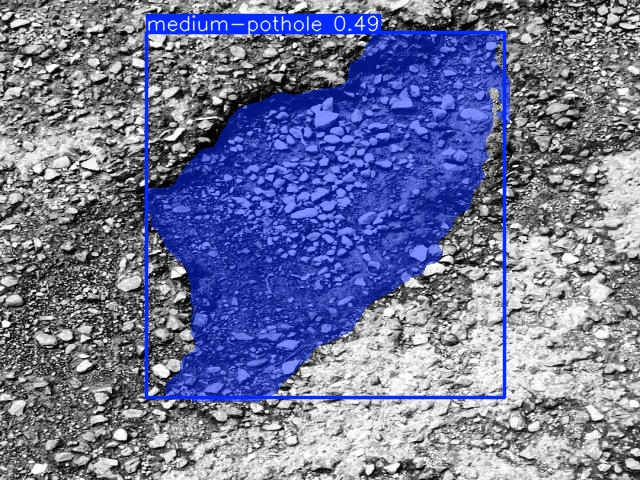

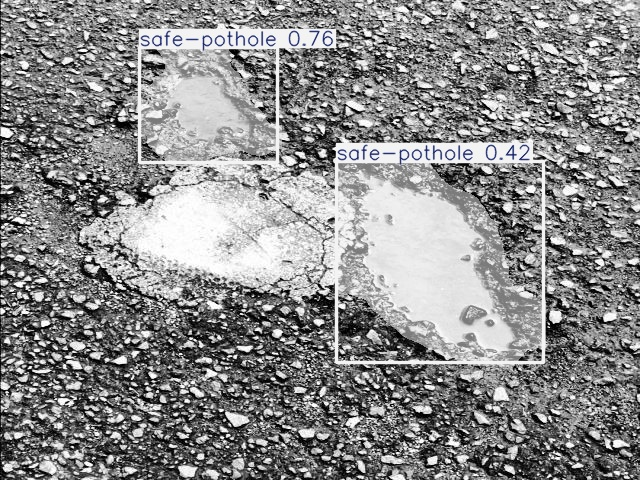

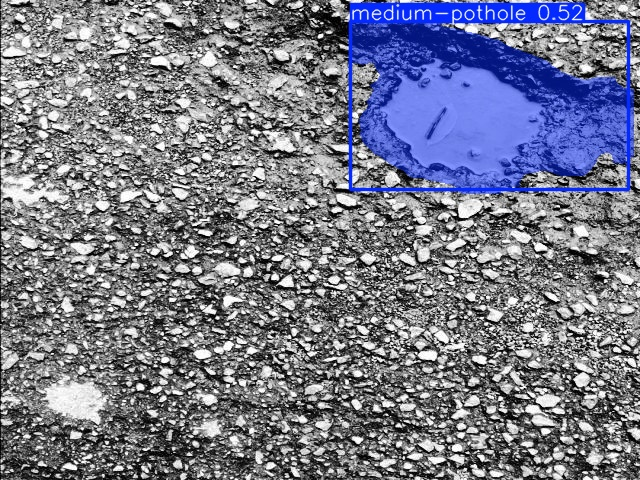

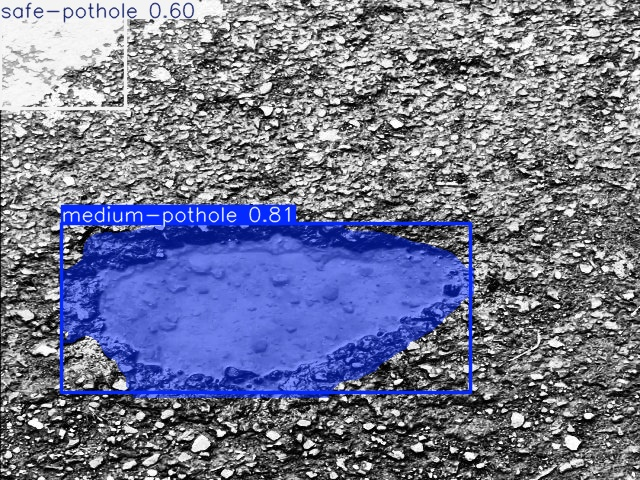

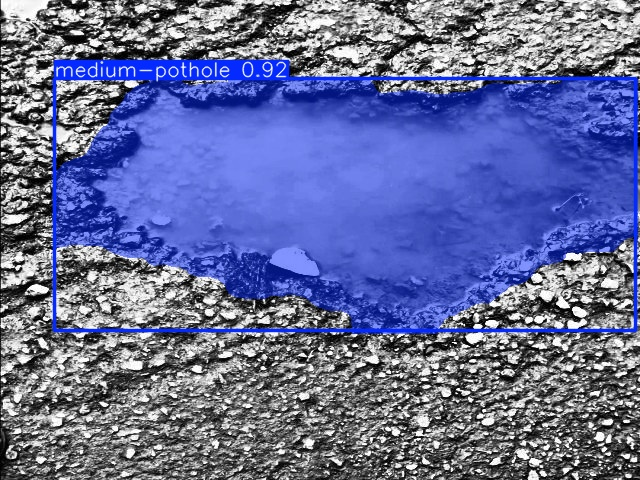

...

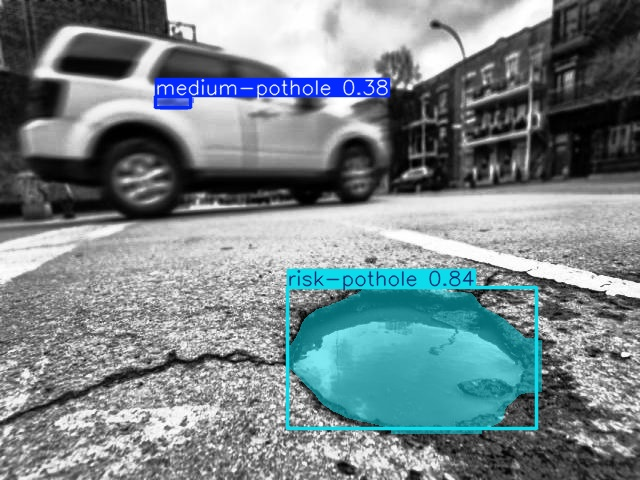

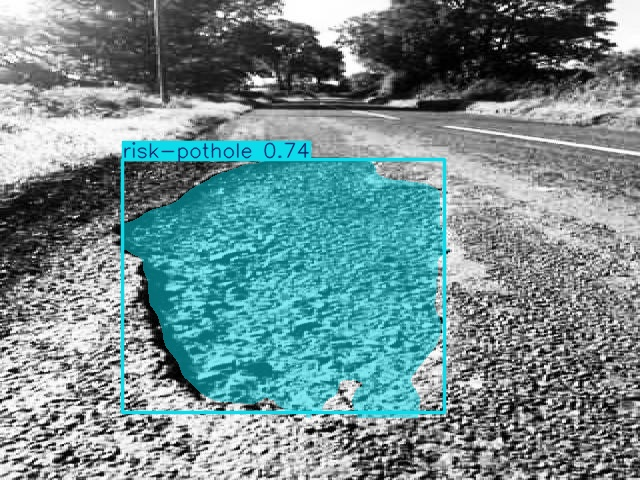

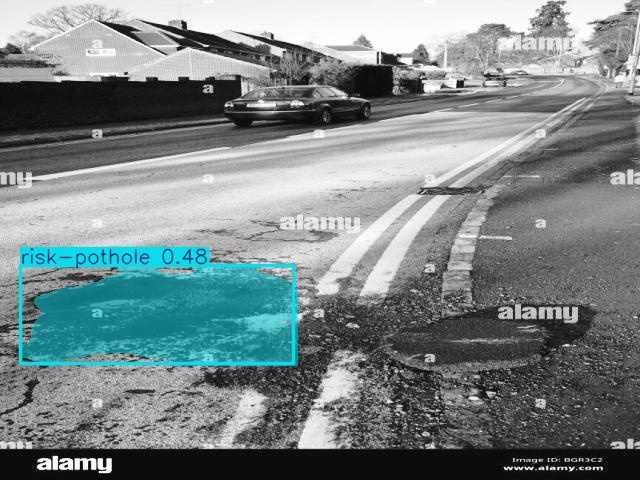

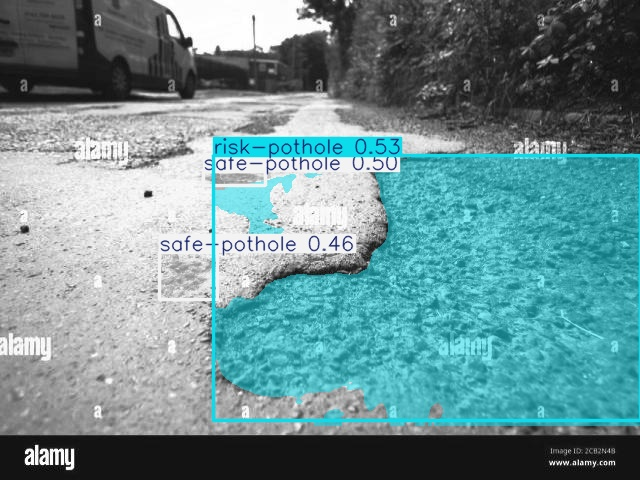

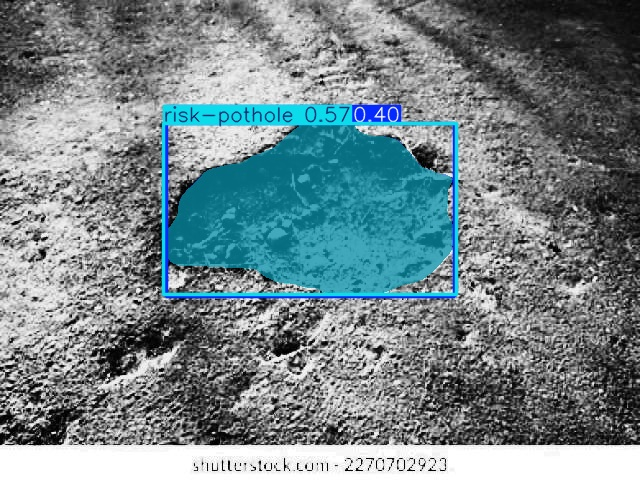

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/Detection-Potholes-v2/runs/segment/predict/*.jpg'):
  display(Image(filename=imageName))
  print("\n")

# **Load MiDaS Model**
*For depth estimation*

In [11]:
# model_path = '/content/drive/MyDrive/Potholes-Detection/runs/segment/train3/weights/best.pt'
model = YOLO(model_re_path)

In [12]:
# !pip -q uninstall torch torchvision torchaudio -y
!pip -q install torch torchvision torchaudio
!pip -q install torch

In [13]:
!pip -q install opencv-python timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 30.6 MB/s eta 0:00:00


In [14]:
import torch
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import cv2
from ultralytics import YOLO
from torchvision.transforms import ToTensor
import torch.nn.functional as F

# Load the MiDaS model for depth estimation
midas = torch.hub.load("intel-isl/MiDaS", "DPT_Large")
midas_transform = torch.hub.load("intel-isl/MiDaS", "transforms").dpt_transform

# Check if GPU is available, otherwise use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Move the model to the appropriate device
midas.to(device)
midas.eval()

/usr/local/lib/python3.10/dist-packages/torch/hub.py:295: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/isl-org/MiDaS/releases/download/v3/dpt_large_384.pt" to /root/.cache/torch/hub/checkpoints/dpt_large_384.pt
100%|██████████| 1.28G/1.28G [00:16<00:00, 82.6MB/s]


Using device: cpu


Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


DPTDepthModel(
  (pretrained): Module(
    (model): VisionTransformer(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
        (norm): Identity()
      )
      (pos_drop): Dropout(p=0.0, inplace=False)
      (patch_drop): Identity()
      (norm_pre): Identity()
      (blocks): Sequential(
        (0): Block(
          (norm1): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (qkv): Linear(in_features=1024, out_features=3072, bias=True)
            (q_norm): Identity()
            (k_norm): Identity()
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=1024, out_features=1024, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
          )
          (ls1): Identity()
          (drop_path1): Identity()
          (norm2): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(in_featur

# **Classify Potholes with Severity**

In [15]:
def calculate_pothole_sizes(image):
    image_np = np.array(image.convert('L'))
    image_np = cv2.resize(image_np, (640, 480))
    image_np = cv2.equalizeHist(image_np)
    image_np = cv2.cvtColor(image_np, cv2.COLOR_GRAY2BGR)

    # results = model.predict(source=image_np, save=False, imgsz=640, conf=0.7, iou=0.4)
    # results = model.predict(source=image_np, save=False, imgsz=640, conf=0.3, iou=0.4)
    results = model.predict(source=image_np, save=False, conf=0.35, iou=0.7)

    pothole_data = []

    # Check if any potholes were detected
    if results[0].boxes:
        for result in results:
            for i, mask in enumerate(result.masks.data):
                mask_np = mask.cpu().numpy()
                area_pixels = np.sum(mask_np)

                confidence = result.boxes.conf[i].item()
                label = result.names[int(result.boxes.cls[i])]

                pothole_data.append({
                    'pothole_id': i,
                    'confidence': confidence,
                    'area_pixels': area_pixels,
                    'box': result.boxes.xyxy[i].cpu().numpy(),
                    'label': label
                })

    return pothole_data, image_np

In [16]:
def estimate_depth(image):
    image_resized = image.resize((640, 480))

    img_np = np.array(image_resized)
    img_tensor = ToTensor()(img_np)
    img = img_tensor.float() / 255.0
    img = img.unsqueeze(0)
    img = img.to(device)

    with torch.no_grad():
        depth_map = midas(img)
        depth_map = torch.nn.functional.interpolate(
            depth_map.unsqueeze(1),
            size=(640, 480),
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    depth_map = depth_map.cpu().numpy()
    return depth_map


def calculate_pothole_depth(results, depth_map):
    if results is None:
        return []

    # Initialize a list to store pothole depths
    pothole_depths = []

    # Get the size of the depth map
    depth_h, depth_w = depth_map.shape

    # Iterate over each result (pothole)
    for result in results:
        if result.masks is None:
            continue

        for i, mask in enumerate(result.masks.data):
            mask_np = mask.cpu().numpy().astype(bool)

            # Resize the mask to match the depth map dimensions
            mask_resized = F.interpolate(
                torch.tensor(mask_np, dtype=torch.float32).unsqueeze(0).unsqueeze(0),
                size=(depth_h, depth_w),
                mode="nearest"
            ).squeeze().bool().numpy()

            # Use the resized mask to extract depth values
            depth_values = depth_map[mask_resized]

            if len(depth_values) > 0:  # Ensure there are depth values in the mask
                avg_depth = np.mean(depth_values)
                max_depth = np.max(depth_values)

                pothole_depths.append({
                    'pothole_id': i,
                    'avg_depth': avg_depth,
                    'max_depth': max_depth,
                    'box': result.boxes.xyxy[i].cpu().numpy()
                })
            else:
                print(f"Warning: No depth values found for pothole {i}")

    return pothole_depths

In [17]:
def classify_potholes(pothole_data, pothole_depths):
    classified_potholes = []

    label_severity_map = {
        "risk-pothole": "high",
        "medium-pothole": "medium",
        "safe-pothole": "low"
    }

    for pothole in pothole_data:
        corresponding_depth = next(
            (depth for depth in pothole_depths if depth['pothole_id'] == pothole['pothole_id']), None)

        if corresponding_depth:
            avg_depth = corresponding_depth['avg_depth']
            max_depth = corresponding_depth['max_depth']
            area_pixels = pothole['area_pixels']
            label = pothole['label']

            # Use the label_severity_map to determine severity
            severity = label_severity_map.get(label, "low")

            classified_potholes.append({
                'pothole_id': pothole['pothole_id'],
                'severity': severity,
                'avg_depth': avg_depth,
                'max_depth': max_depth,
                'area_pixels': area_pixels,
                'box': pothole['box'],
                'label': label
            })

    return classified_potholes

In [18]:
def draw_severity_on_image(image_np, classified_potholes):
    # Convert NumPy array back to PIL Image for drawing
    image_pil = Image.fromarray(image_np)
    draw = ImageDraw.Draw(image_pil)

    # Load a font
    try:
        font = ImageFont.load("arial.pil")
    except IOError:
        font = ImageFont.load_default()

    for pothole in classified_potholes:
        box = pothole['box']
        severity = pothole['severity']
        label = pothole['label']

        # Define text content
        text_content = f"{label}: {severity}"

        # Calculate text size
        text_size = draw.textsize(text_content, font=font)

        # Define text position ensuring it stays within the image boundaries
        text_position = (max(box[0], 5), max(box[1] - text_size[1] - 5, 5))

        # Define the rectangle for the text background
        text_background = [
            (text_position[0] - 2, text_position[1] - 2),  # Top-left corner
            (text_position[0] + text_size[0] + 2, text_position[1] + text_size[1] + 2)  # Bottom-right corner
        ]

        # Draw rectangle background for text
        draw.rectangle(text_background, fill="white")

        # Draw the rectangle around the pothole
        draw.rectangle([(box[0], box[1]), (box[2], box[3])], outline="red", width=3)

        # Draw severity label on top of the background
        draw.text(text_position, text_content, fill="blue", font=font, align='center')

    # Convert back to NumPy array
    image_np_with_severity = np.array(image_pil)

    return image_np_with_severity



0: 448x640 5 medium-potholes, 2 risk-potholes, 134.4ms
Speed: 5.8ms preprocess, 134.4ms inference, 918.4ms postprocess per image at shape (1, 3, 448, 640)
Detection results:
Detected: risk-pothole, Confidence: 0.9237172603607178
Detected: medium-pothole, Confidence: 0.6743735074996948
Detected: medium-pothole, Confidence: 0.6446778774261475
Detected: risk-pothole, Confidence: 0.541693925857544
Detected: medium-pothole, Confidence: 0.4851037561893463
Detected: medium-pothole, Confidence: 0.4146879315376282
Detected: medium-pothole, Confidence: 0.38823264837265015

0: 480x640 6 medium-potholes, 2 risk-potholes, 53.1ms
Speed: 1.9ms preprocess, 53.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
id:0, severity-high, area: 2320.0, avg-depth: 22.102602005004883, max-depth: 23.476903915405273
id:1, severity-medium, area: 948.0, avg-depth: 18.97273826599121, max-depth: 19.67110824584961
id:2, severity-medium, area: 1012.0, avg-depth: 18.629329681396484, max-depth: 19.30872

<ipython-input-20-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-20-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-20-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-20-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-20-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox o

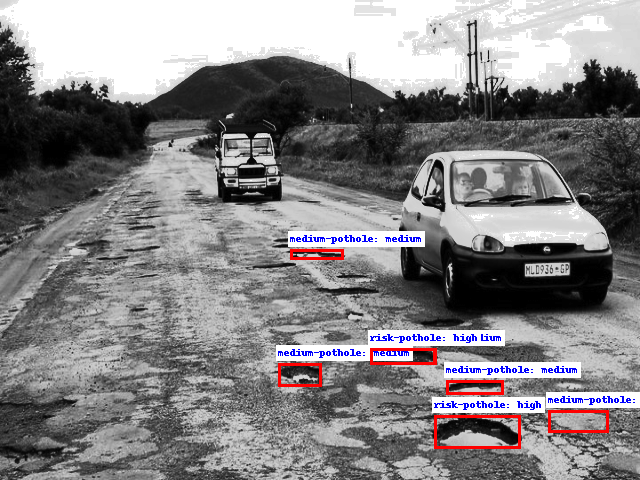

In [ ]:
# Example usage:
image_path = '/content/drive/MyDrive/Detection-Potholes-v2/test_M1.jpg'
image = Image.open(image_path)

# Perform object detection
# results = model(image_path)
results = model.predict(source=image, save=False, conf=0.35, iou=0.7)

# Debugging: Print detection results
print("Detection results:")
for result in results:
    for i, box in enumerate(result.boxes.xyxy):
        print(f"Detected: {result.names[int(result.boxes.cls[i])]}, Confidence: {result.boxes.conf[i].item()}")

# Estimate depth
depth_map = estimate_depth(image)

# Calculate pothole sizes using the detection results
pothole_data, image_np = calculate_pothole_sizes(image)

# Calculate pothole depths using the detection results and the depth map
pothole_depths = calculate_pothole_depth(results, depth_map)

# Classify potholes based on size and depth
classified_potholes = classify_potholes(pothole_data, pothole_depths)

# Print severity information for debugging
for item in classified_potholes:
    print(f"id:{item['pothole_id']}, severity-{item['severity']}, area: {item['area_pixels']}, avg-depth: {item['avg_depth']}, max-depth: {item['max_depth']}")

# Draw severity on image
image_with_severity = draw_severity_on_image(image_np, classified_potholes)

# Convert the result back to a PIL image and display/save it
result_image = Image.fromarray(image_with_severity)
result_image # To display the image
# result_image.save("/content/drive/MyDrive/Detection-Potholes/output_with_severity.jpg")  # Save the image if needed



0: 480x640 2 medium-potholes, 13502.0ms
Speed: 15.4ms preprocess, 13502.0ms inference, 125.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 medium-potholes, 5252.8ms
Speed: 5.1ms preprocess, 5252.8ms inference, 11.8ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


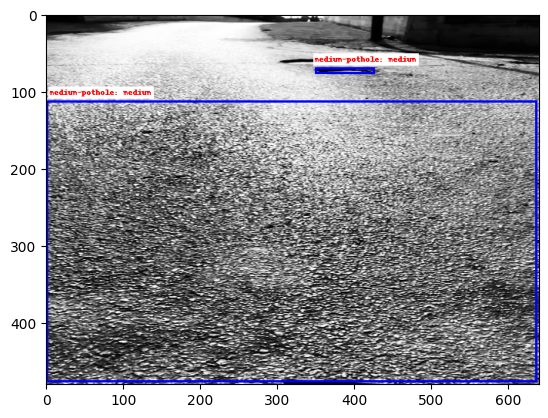


0: 480x640 2 medium-potholes, 4593.8ms
Speed: 9.6ms preprocess, 4593.8ms inference, 8.1ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 medium-potholes, 4591.0ms
Speed: 3.2ms preprocess, 4591.0ms inference, 7.3ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


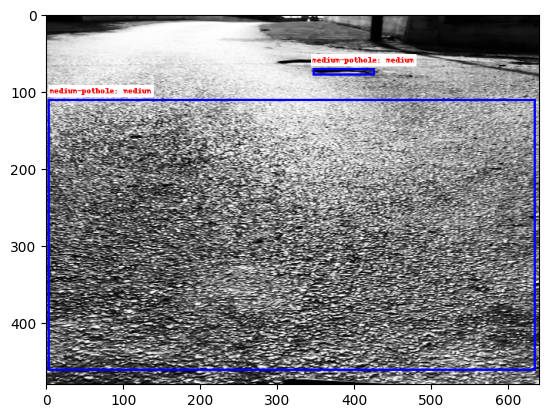


0: 480x640 2 medium-potholes, 8293.6ms
Speed: 2.6ms preprocess, 8293.6ms inference, 7.2ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 medium-potholes, 4366.8ms
Speed: 4.7ms preprocess, 4366.8ms inference, 8.2ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


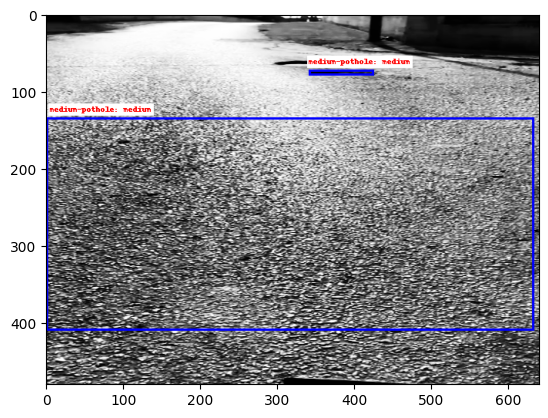


0: 480x640 3 medium-potholes, 4230.3ms
Speed: 3.0ms preprocess, 4230.3ms inference, 14.0ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 medium-potholes, 4228.7ms
Speed: 3.1ms preprocess, 4228.7ms inference, 7.4ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


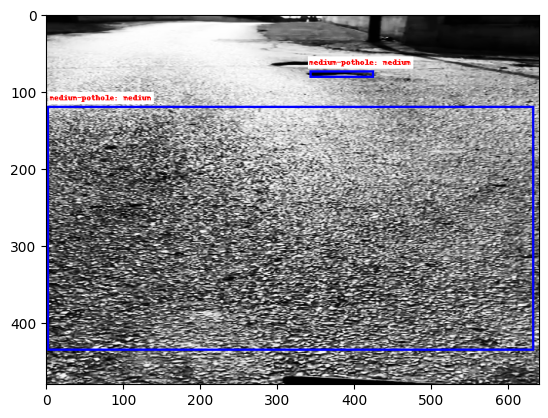


0: 480x640 1 medium-pothole, 6010.9ms
Speed: 2.6ms preprocess, 6010.9ms inference, 6.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 5679.0ms
Speed: 2.6ms preprocess, 5679.0ms inference, 6.3ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


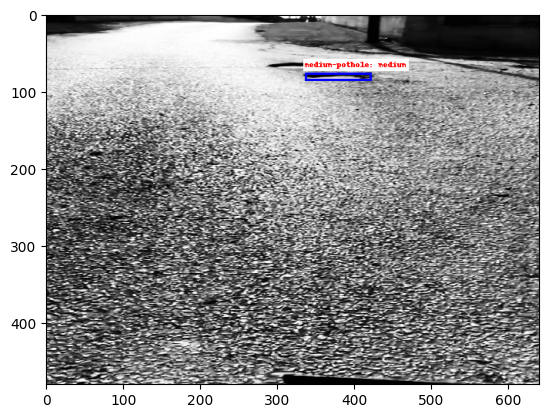


0: 480x640 2 medium-potholes, 4383.7ms
Speed: 2.7ms preprocess, 4383.7ms inference, 8.2ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 4252.8ms
Speed: 2.9ms preprocess, 4252.8ms inference, 4.1ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


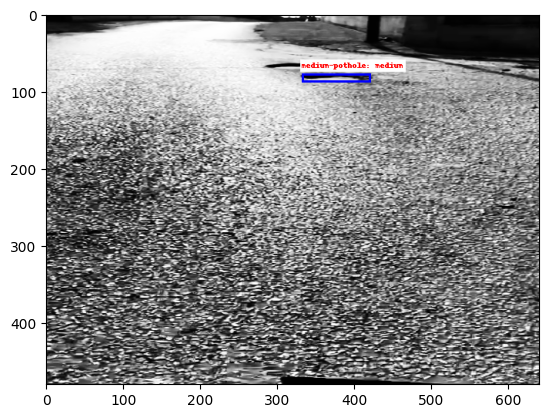


0: 480x640 2 medium-potholes, 4307.6ms
Speed: 2.8ms preprocess, 4307.6ms inference, 7.7ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 medium-potholes, 4250.8ms
Speed: 3.2ms preprocess, 4250.8ms inference, 7.2ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


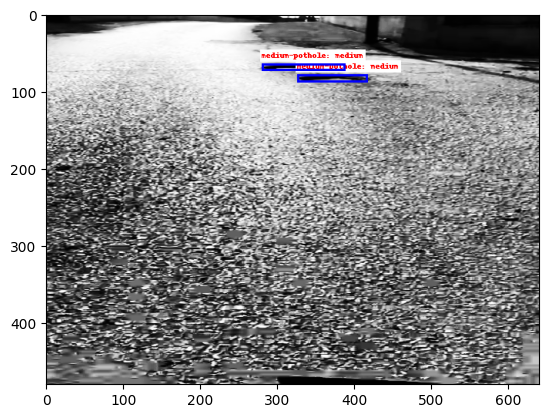


0: 480x640 (no detections), 6286.1ms
Speed: 2.6ms preprocess, 6286.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 6161.4ms
Speed: 3.9ms preprocess, 6161.4ms inference, 4.0ms postprocess per image at shape (1, 3, 480, 640)


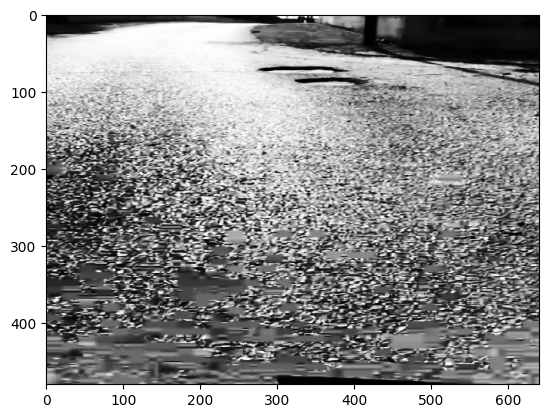


0: 480x640 2 medium-potholes, 4303.2ms
Speed: 2.9ms preprocess, 4303.2ms inference, 7.7ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 4314.0ms
Speed: 2.8ms preprocess, 4314.0ms inference, 4.4ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


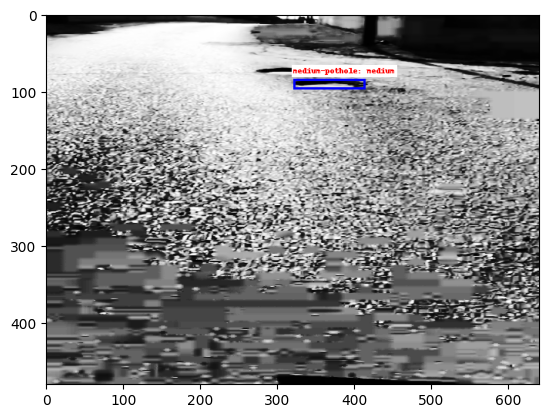


0: 480x640 2 medium-potholes, 4303.7ms
Speed: 2.4ms preprocess, 4303.7ms inference, 7.0ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 4875.9ms
Speed: 10.7ms preprocess, 4875.9ms inference, 9.0ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


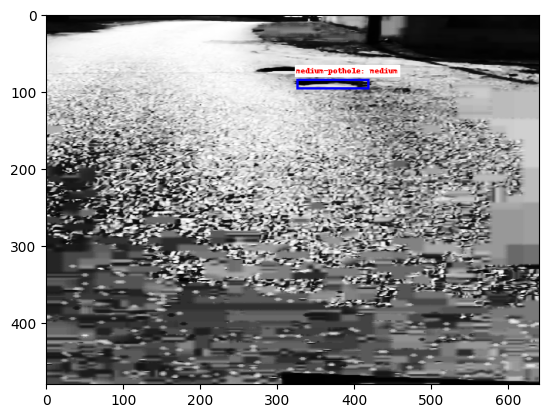


0: 480x640 2 medium-potholes, 5756.5ms
Speed: 3.7ms preprocess, 5756.5ms inference, 7.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 medium-pothole, 5726.8ms
Speed: 2.8ms preprocess, 5726.8ms inference, 4.1ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


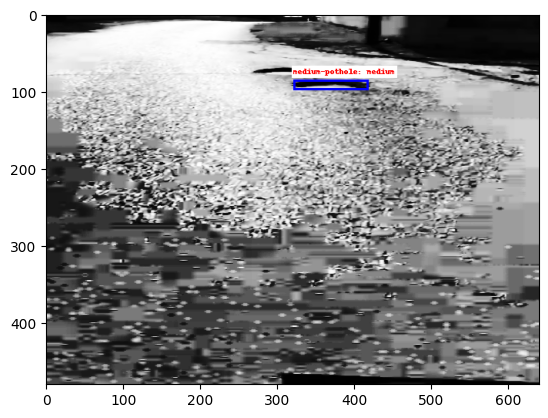


0: 480x640 2 medium-potholes, 4272.5ms
Speed: 2.5ms preprocess, 4272.5ms inference, 7.1ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 risk-potholes, 4314.7ms
Speed: 3.4ms preprocess, 4314.7ms inference, 7.8ms postprocess per image at shape (1, 3, 480, 640)


<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)
<ipython-input-18-0e2d5b2dcd16>:21: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text_content, font=font)


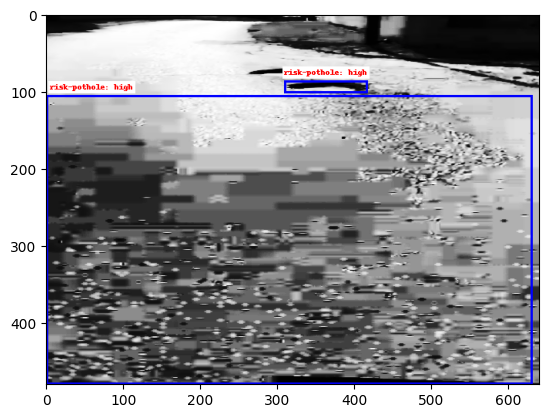


0: 480x640 2 medium-potholes, 5276.9ms
Speed: 3.8ms preprocess, 5276.9ms inference, 12.4ms postprocess per image at shape (1, 3, 480, 640)


KeyboardInterrupt: 

In [19]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
from PIL import Image

video_path = '/content/drive/MyDrive/Detection-Potholes-v2/VID-20240820-WA0009.mp4'
cap = cv2.VideoCapture(video_path)
fourcc = cv2.VideoWriter_fourcc(*'XVID')

# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
# out = cv2.VideoWriter('output_test.mp4', fourcc, fps, (width, height))
out = cv2.VideoWriter('output_gradio.avi', fourcc, 30.0, (640, 480))
frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1
    if frame_count % 3 != 0:
        continue

    # Resize the frame to (640, 480)
    frame = cv2.resize(frame, (640, 480))

    # Convert the frame to a PIL image
    image = Image.fromarray(frame)

    # Perform object detection
    results = model.predict(source=image, save=False, conf=0.35, iou=0.7)

    if results is None:  # if no objects were detected, skip this frame
        continue

    # Estimate depth
    depth_map = estimate_depth(image)

    # Calculate pothole sizes using the detection results
    pothole_data, image_np = calculate_pothole_sizes(image)

    # Calculate pothole depths using the detection results and the depth map
    pothole_depths = calculate_pothole_depth(results, depth_map)

    # Classify potholes based on size and depth
    classified_potholes = classify_potholes(pothole_data, pothole_depths)

    # Draw severity on image
    image_with_severity = draw_severity_on_image(image_np, classified_potholes)

    # Display the output
    plt.imshow(cv2.cvtColor(image_with_severity, cv2.COLOR_BGR2RGB))
    plt.show()

    # Write the output to the video file
    out.write(image_with_severity)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources and close the window
cap.release()
out.release()
cv2.destroyAllWindows()

# **User Interface with Video**

In [20]:
!pip -q install gradio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 46.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.3/10.3 MB 52.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 8.1 MB/s eta 0:00:00


In [24]:
from functools import cache
import gradio as gr
from PIL import Image
import numpy as np
import cv2

def process_video(video):
    try:
        # Initialize video capture
        cap = cv2.VideoCapture(video)

        # Initialize video writer
        fourcc = cv2.VideoWriter_fourcc(*'XVID')
        out = cv2.VideoWriter('output_gradio_w1.avi', fourcc, 30.0, (640, 480))

        # Initialize frame counter
        frame_count = 0

        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break

            # Increment frame counter
            frame_count += 1

            # Only process every second (30 frames)
            # if frame_count % 30 != 0:
            #     continue

            if frame_count % 3 != 0:
                continue

            # Resize frame to (640, 480)
            frame = cv2.resize(frame, (640, 480))

            # Convert frame to PIL image
            image = Image.fromarray(frame)

            # Perform object detection (Segmentation mask generation)
            results = model.predict(source=image, save=False, conf=0.35, iou=0.7)

            # Estimate depth
            depth_map = estimate_depth(image)

            # Calculate pothole sizes
            pothole_data, image_np = calculate_pothole_sizes(image)

            # Calculate pothole depths
            pothole_depths = calculate_pothole_depth(results, depth_map)

            # Classify potholes based on size and depth
            classified_potholes = classify_potholes(pothole_data, pothole_depths)

            # Draw severity on image
            image_with_severity = draw_severity_on_image(image_np, classified_potholes)

            # Write output to video file
            out.write(image_with_severity)

        # Release video capture and writer
        cap.release()
        out.release()

        # Return output video file
        return 'output_gradio_w1.avi'

    except Exception as e:
        print(f"Error in process_video: {e}")
        return None

def create_gradio_interface():
    with gr.Blocks() as demo:
        gr.Markdown("## Pothole Detection and Depth Estimation")

        # Input: Upload video
        with gr.Row():
            video_input = gr.Video(label="Upload Video")

        # Output: Annotated video
        with gr.Row():
            video_output = gr.Video(label="Annotated Video")

        # Define the function that processes the input and produces output
        video_input.change(
            fn=process_video,
            inputs=video_input,
            outputs=video_output
            )

    return demo

# Launch the Gradio app
if __name__ == "__main__":
    gr_interface = create_gradio_interface()
    # gr_interface.launch(debug=True)
    gr_interface.launch()

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://ba080dfbb679975c21.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


In [21]:
# from functools import cache
# import gradio as gr
# from PIL import Image
# import numpy as np
# import cv2

# def process_video(video):
#     try:
#         # Initialize video capture
#         cap = cv2.VideoCapture(video)

#         # Initialize video writer
#         fourcc = cv2.VideoWriter_fourcc(*'XVID')
#         out = cv2.VideoWriter('output_gradio123.avi', fourcc, 30.0, (640, 480))

#         # Initialize frame counter
#         frame_count = 0

#         while cap.isOpened():
#             ret, frame = cap.read()
#             if not ret:
#                 break

#             # Increment frame counter
#             frame_count += 1

#             # Resize frame to (640, 480)
#             frame = cv2.resize(frame, (640, 480))

#             # Convert frame to PIL image
#             image = Image.fromarray(frame)

#             # Perform object detection (Segmentation mask generation)
#             results = model.predict(source=image, save=False, conf=0.35, iou=0.7)

#             # Estimate depth using the segmentation mask
#             depth_map = estimate_depth(image)

#             # Calculate pothole sizes
#             pothole_data, image_np = calculate_pothole_sizes(image)

#             # Calculate pothole depths
#             pothole_depths = calculate_pothole_depth(results, depth_map)

#             # Classify potholes based on size and depth
#             classified_potholes = classify_potholes(pothole_data, pothole_depths)

#             # Draw severity on image
#             image_with_severity = draw_severity_on_image(image_np, classified_potholes)

#             # Write output to video file
#             out.write(image_with_severity)

#         # Release video capture and writer
#         cap.release()
#         out.release()

#         # Return output video file
#         return 'output_gradio123.avi'

#     except Exception as e:
#         print(f"Error in process_video: {e}")
#         return None

# def create_gradio_interface():
#     with gr.Blocks() as demo:
#         gr.Markdown("## Pothole Detection and Depth Estimation")

#         # Input: Upload video
#         with gr.Row():
#             video_input = gr.Video(label="Upload Video")

#         # Output: Annotated video
#         with gr.Row():
#             video_output = gr.Video(label="Annotated Video")

#         # Define the function that processes the input and produces output
#         video_input.change(
#             fn=process_video,
#             inputs=video_input,
#             outputs=video_output
#             )

#     return demo

# # Launch the Gradio app
# if __name__ == "__main__":
#     gr_interface = create_gradio_interface()
#     # gr_interface.launch(debug=True)
#     gr_interface.launch()

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://1e7a90e50c4f706e3e.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


# **User Interface with images**

In [22]:
from functools import cache
import gradio as gr
from PIL import Image
import numpy as np

def process_image(image):
    try:
        image_np = np.array(image.convert('L'))
        image_np = cv2.resize(image_np, (640, 480))
        image_np = cv2.equalizeHist(image_np)
        image_np = cv2.cvtColor(image_np, cv2.COLOR_GRAY2BGR)

        
        # results = model(image)
        results = model.predict(source=image_np, save=False, conf=0.35, iou=0.7)
        segmentation_mask = results[0].plot()  # Assuming 'results' contains the segmentation mask

        # Convert segmentation mask (NumPy array) to PIL Image for Gradio
        segmentation_mask_image = Image.fromarray(segmentation_mask)

        # Estimate depth
        depth_map = estimate_depth(image)

        # Convert depth_map (NumPy array) to PIL Image for Gradio
        depth_map_image = Image.fromarray((depth_map * 255 / np.max(depth_map)).astype(np.uint8))

        # Calculate pothole sizes
        pothole_data, image_np = calculate_pothole_sizes(image)

        # Calculate pothole depths
        pothole_depths = calculate_pothole_depth(results, depth_map)

        # Classify potholes based on size and depth
        classified_potholes = classify_potholes(pothole_data, pothole_depths)

        # Draw severity on image
        image_with_severity = draw_severity_on_image(image_np, classified_potholes)

        # return image_with_severity, depth_map_image, segmentation_mask_image
        return image_with_severity, segmentation_mask_image

    except Exception as e:
        print(f"Error in process_image: {e}")
        return None, None, None



def create_gradio_interface():
    with gr.Blocks() as demo:
        gr.Markdown("## Pothole Detection and Depth Estimation")

        # Input: Upload image
        with gr.Row():
            image_input = gr.Image(type="pil", label="Upload Image")

        with gr.Row():
            image_with_severity = gr.Image(type="pil", label="Classify with Severity")
            # depth_output = gr.Image(type="pil", label="Depth Map")
            mask_output = gr.Image(type="pil", label="Segmentation Mask (Used for Depth Estimation)")

        # Define the function that processes the input and produces outputs
        image_input.change(
            fn=process_image,
            inputs=image_input,
            # outputs=[segmentation_output, depth_output, mask_output]
            outputs=[image_with_severity, mask_output]
            )

    return demo

# Launch the Gradio app
if __name__ == "__main__":
    gr_interface = create_gradio_interface()
    # gr_interface.launch(debug=True)
    gr_interface.launch()


Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://e98593597b0549b9ac.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


In [ ]:
### Functions

#### `calculate_pothole_sizes`

This function calculates the size of each detected pothole in pixels. It takes an image as input, processes it using OpenCV and PIL libraries, and returns a list of pothole data, including the pothole ID, confidence, area in pixels, bounding box, and label.

#### `estimate_depth`

This function estimates the depth of each pothole using the MiDaS model. It takes an image as input, resizes it to (640, 480), and returns a depth map.

#### `calculate_pothole_depth`

This function calculates the average and maximum depth of each pothole. It takes the results from the object detection model and the depth map as input, and returns a list of pothole depth data, including the pothole ID, average depth, maximum depth, and bounding box.

#### `classify_potholes`

This function classifies each pothole based on its size, depth, and label. It takes the pothole data and pothole depth data as input, and returns a list of classified potholes, including the pothole ID, severity level, average depth, maximum depth, area in pixels, bounding box, and label.